VisiumHD represents a revolutionary technology, potentially as impactful as the introduction of droplet-based single-cell methods. By eliminating gaps between spots, VisiumHD enables continuous and detailed tissue mapping, offering a subcellular resolution of 2µm. This resolution greatly improving the precision and accuracy of cellular reconstructions. As the technology is still in its early development stages, it is crucial to develop strategies that fully exploit the data it provides.

We introduce SMURF (Segmentation and Manifold UnRolling Framework) to leverage soft segmentation with VisiumHD data, facilitating the creation of a cells*genes `anndata` object. SMURF uses high-resolution images from VisiumHD for nuclei segmentation.

In our demonstration, we use [StarDist](https://qupath.readthedocs.io/en/0.3/docs/advanced/stardist.html) for segmentation. Please install StarDist beforehand. Most segmentation tools require deep learning packages, so we recommend using the simplified version of SMURF for analysis. Researchers are encouraged to use their preferred segmentation methods. Please apply your selected method to the image `so.image_temp()`. The segmentation results should be saved either in a 2D NumPy array named `so.segmentation_final` or as a dictionary named `segmentation_results` containing the segmentation output. In these arrays, areas without nuclei should be labeled as `0`, while nucleated areas should be assigned unique cell IDs.


In [1]:
import numpy as np
import matplotlib.pyplot as plt

import smurf as su

In [2]:
data_path = '/home/juanru/Desktop/visuimhd_Data/mousebrain_new/'
save_path = 'results_example_mousebrain/'

### Dataset Information

Access the dataset here: [Visium HD CytAssist Gene Expression Libraries of Mouse Brain](https://www.10xgenomics.com/datasets/visium-hd-cytassist-gene-expression-libraries-of-mouse-brain-he)

### Important Downloads

To download the necessary files, run the following commands:

```python
# Download data from 10x
!mkdir -p "smurf_example_data"
!wget -P smurf_example_data https://cf.10xgenomics.com/samples/spatial-exp/3.0.0/Visium_HD_Mouse_Brain/Visium_HD_Mouse_Brain_tissue_image.tif
!wget -P smurf_example_data https://cf.10xgenomics.com/samples/spatial-exp/3.0.0/Visium_HD_Mouse_Brain/Visium_HD_Mouse_Brain_binned_outputs.tar.gz
!tar -xzvf smurf_example_data/Visium_HD_Mouse_Brain_binned_outputs.tar.gz -C smurf_example_data

```


In [3]:
so = su.prepare_dataframe_image(data_path+'binned_outputs/square_002um/spatial/tissue_positions.parquet',
                                data_path+'Visium_HD_Mouse_Brain_tissue_image.tif',
                               'HE')

In [4]:
i_max = so.image_temp().shape[0]
j_max = so.image_temp().shape[1]
num = 0
loop = 4700
segmentation_results = {}
gap = 80

In [5]:
# Import the StarDist 2D segmentation models.
# Import the recommended normalization technique for stardist.
from csbdeep.utils import normalize
from stardist.models import StarDist2D
# Import squidpy and additional packages needed for this tutorial.
import squidpy as sq

2024-10-25 05:57:08.643026: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-25 05:57:08.674622: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-25 05:57:08.674651: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-25 05:57:08.675581: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-25 05:57:08.681150: I tensorflow/core/platform/cpu_feature_guar

In [6]:
StarDist2D.from_pretrained("2D_versatile_he")

def stardist_2D_versatile_he(img, nms_thresh=None, prob_thresh=None):
    # axis_norm = (0,1)   # normalize channels independently
    axis_norm = (0, 1, 2)  # normalize channels jointly
    # Make sure to normalize the input image beforehand or supply a normalizer to the prediction function.
    # this is the default normalizer noted in StarDist examples.
    img = normalize(img, 1, 99.8, axis=axis_norm)
    model = StarDist2D.from_pretrained("2D_versatile_he")
    labels, _ = model.predict_instances(
        img, nms_thresh=nms_thresh, prob_thresh=prob_thresh
    )
    return labels

Found model '2D_versatile_he' for 'StarDist2D'.


2024-10-25 05:57:13.318317: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 22272 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3090, pci bus id: 0000:65:00.0, compute capability: 8.6


Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


Since the HE image here is contaminated, we define a function to clean it. There is no need to apply this function to your own image.

In [7]:
import copy

def clean(array_im):
    target_colors = np.array([[155, 60, 126],
                              [128,24,101],
                              [190,118,172],
                              [220,95,176],
                              [139,42,110],
                              [132,39,102],
                              [136,44,108],
                              [125,53,110],
                              [109,39,91],
                              [178,90,144],
                              [149,67,122],
                              [191,70,159],
                              [186,69,150 ],
                              [176,40,132 ]]
                            )

    new_color = [250,139,209]
    threshold = 20
    for target_color in target_colors:
        
        distances = np.sqrt(((array_im - target_color)**2).sum(axis=-1))
        array_im[distances < threshold] = new_color
        
    return array_im



Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


2024-10-25 05:57:15.674335: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-10-25 05:57:15.762017: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-10-25 05:57:18.956139: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


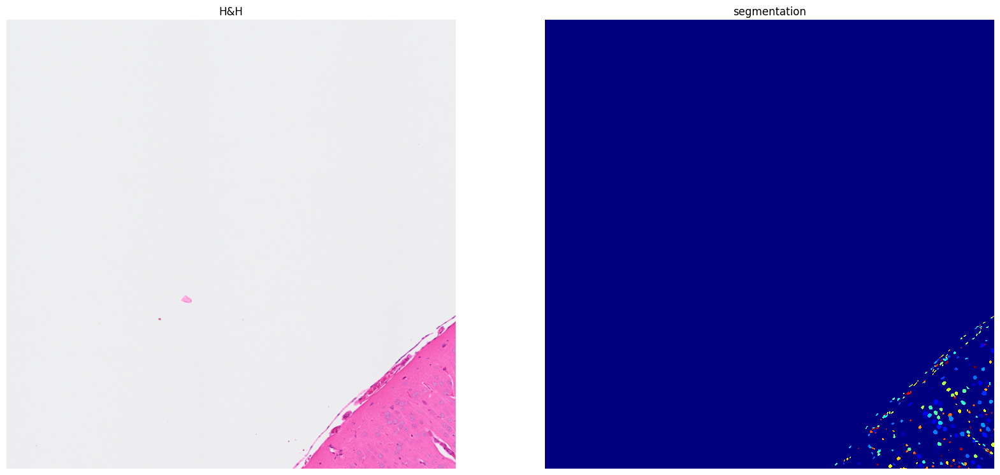

In [8]:
i= loop*0
j = loop*0
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.02,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] =  np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


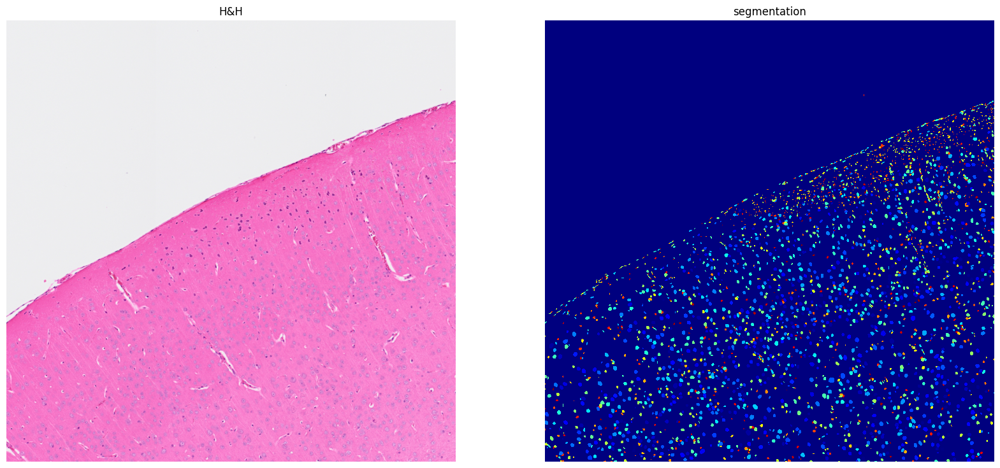

In [9]:
i= loop*0
j = loop*1
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a_t = clean(a_t) # No need to clean for your own data
a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


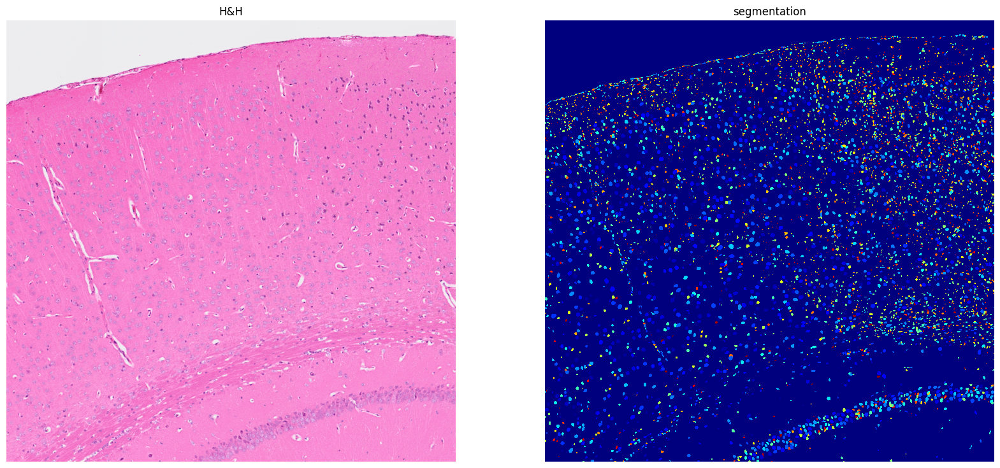

In [10]:
i= loop*0
j = loop*2
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a_t = clean(a_t) # No need to clean for your own data
a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


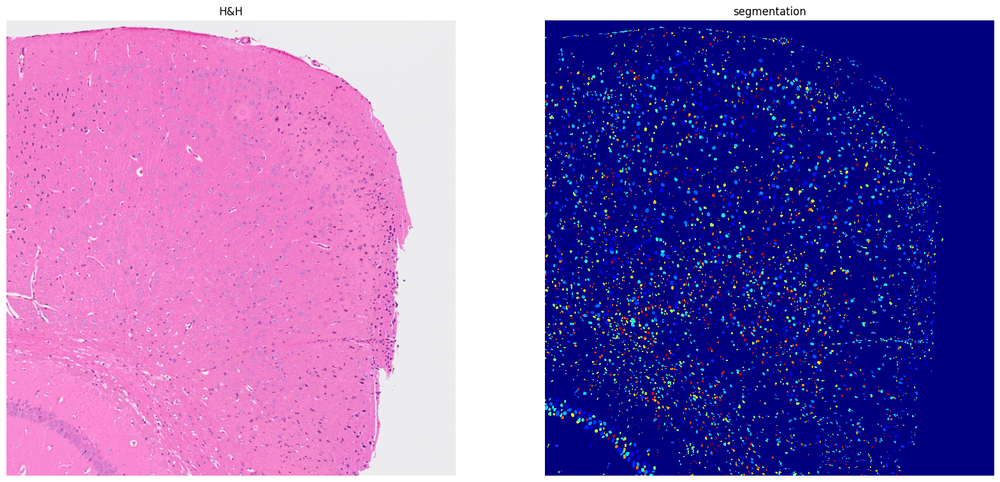

In [11]:
i= loop*0
j = loop*3
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a_t = clean(a_t) # No need to clean for your own data
a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.03,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


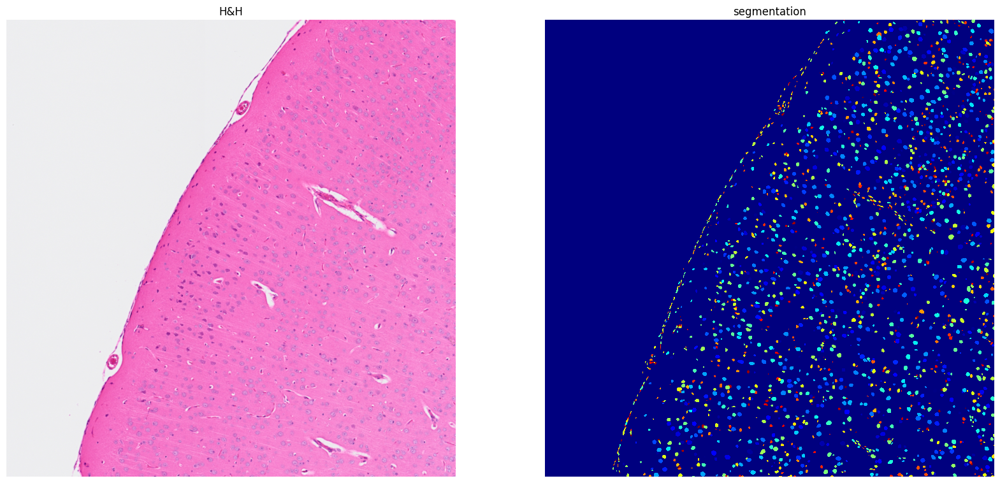

In [12]:
i= loop*1
j = loop*0
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


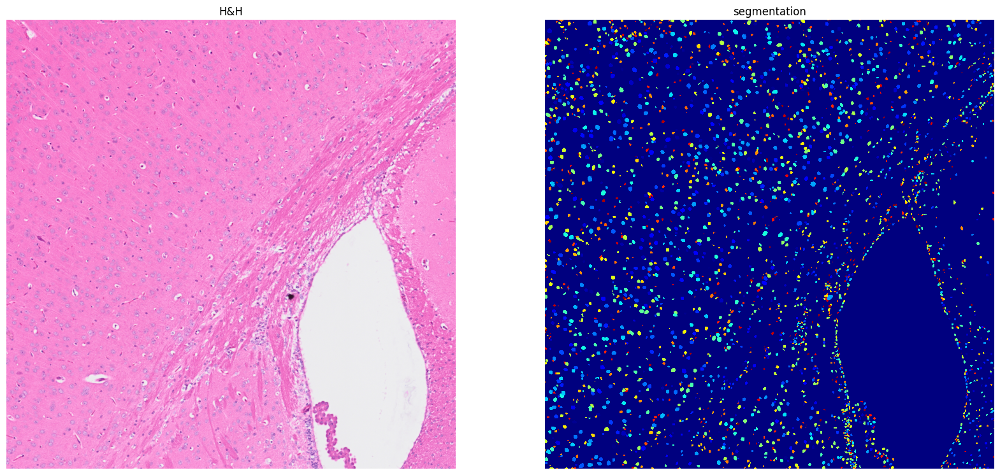

In [13]:
i= loop*1
j = loop*1
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


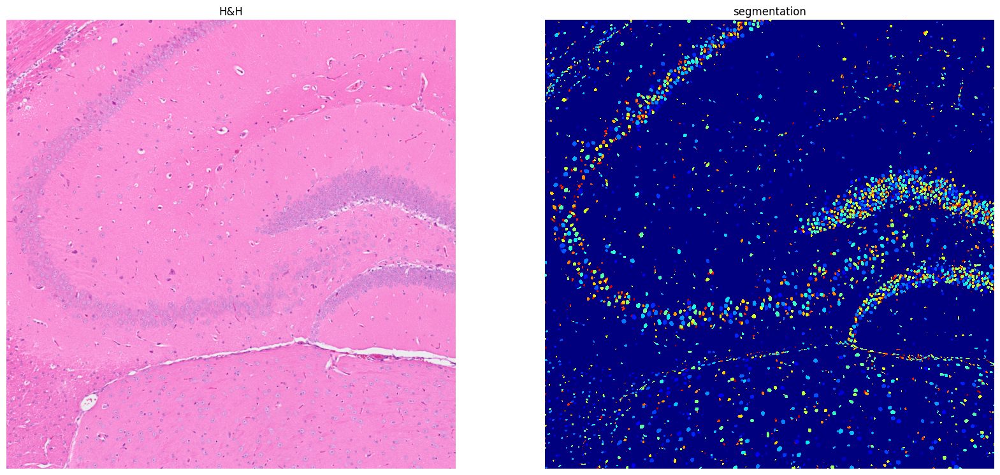

In [14]:
i= loop*1
j = loop*2
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.0065,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


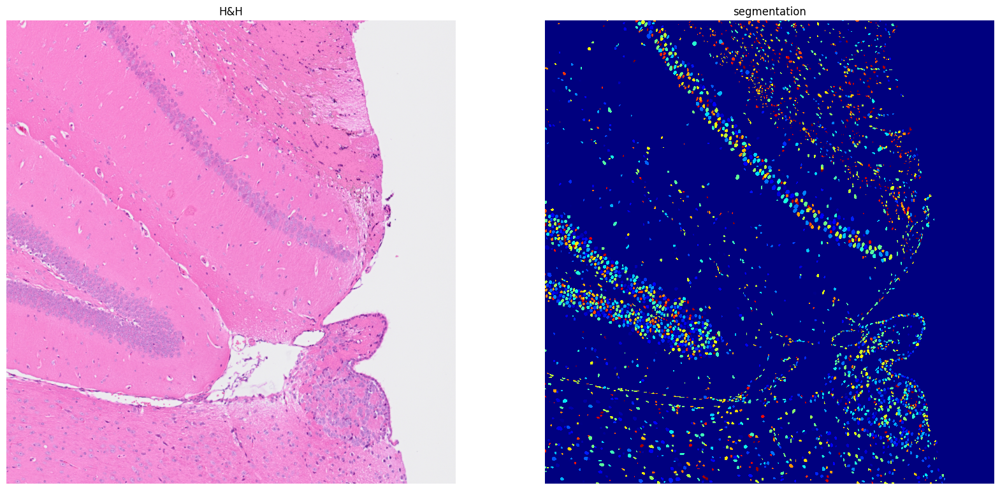

In [15]:
i= loop*1
j = loop*3
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a_t = clean(a_t) # No need to clean for your own data
a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.09,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


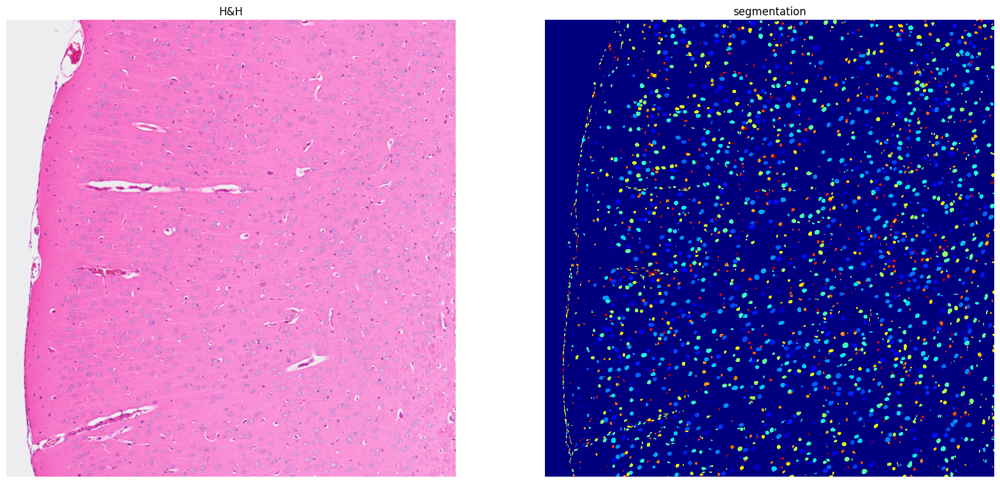

In [16]:
i= loop*2
j = loop*0
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


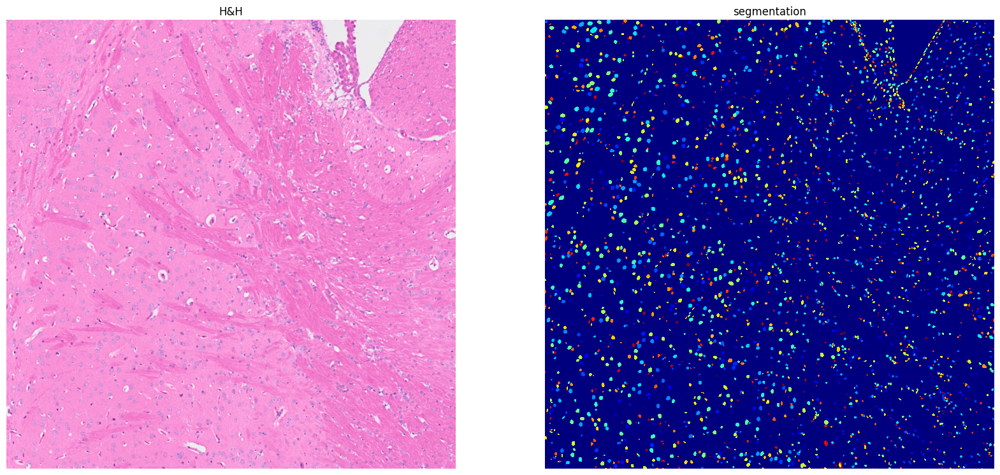

In [17]:
i= loop*2
j = loop*1
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.03,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


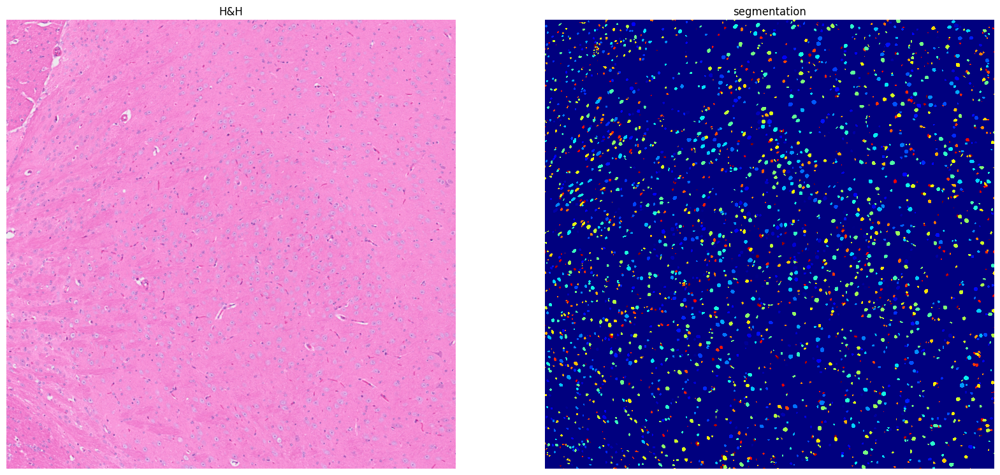

In [18]:
i= loop*2
j = loop*2
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


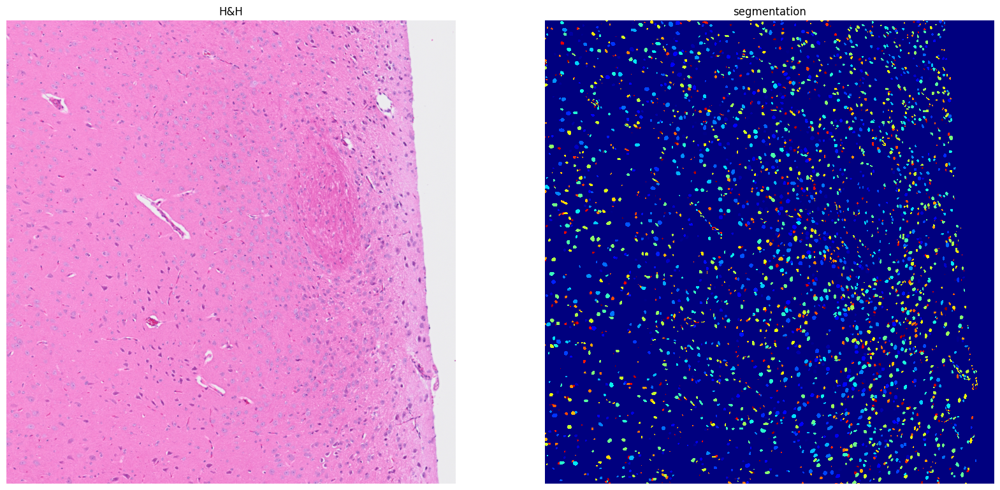

In [19]:
i= loop*2
j = loop*3
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


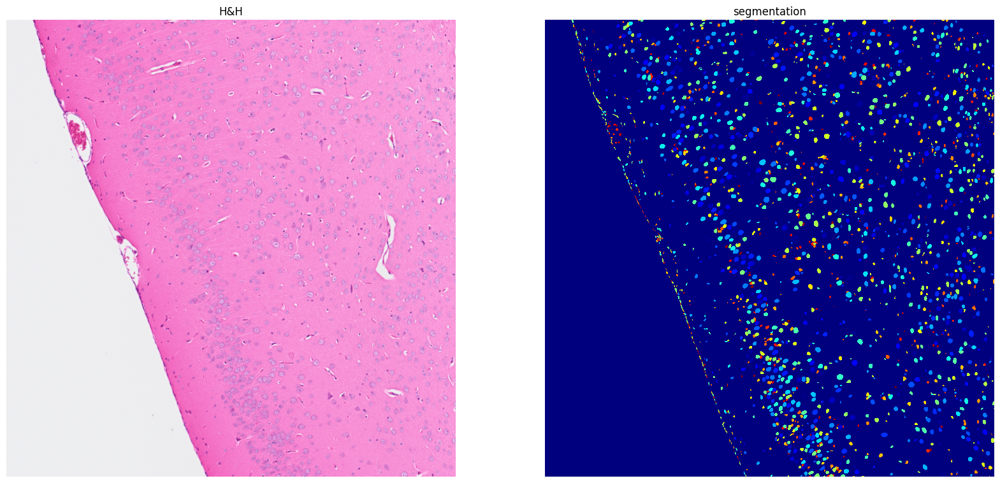

In [20]:
i= loop*3
j = loop*0
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")

segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


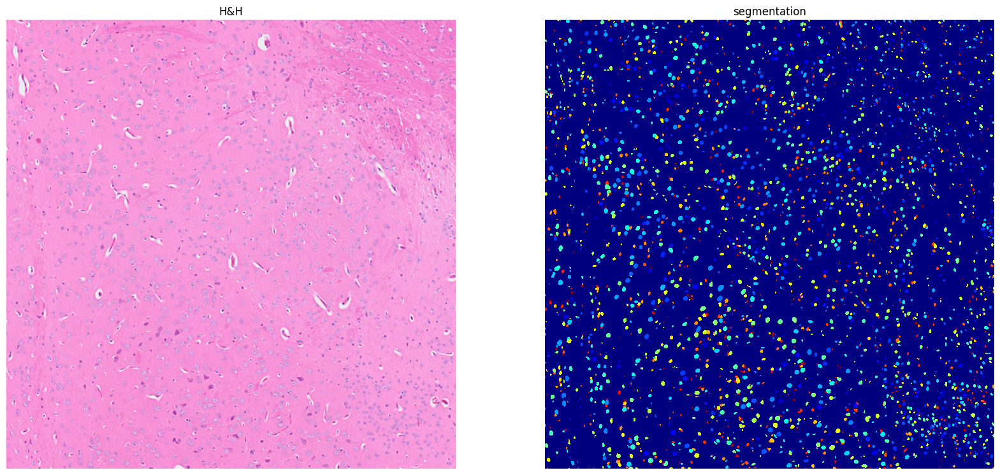

In [21]:
i= loop*3
j = loop*1
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


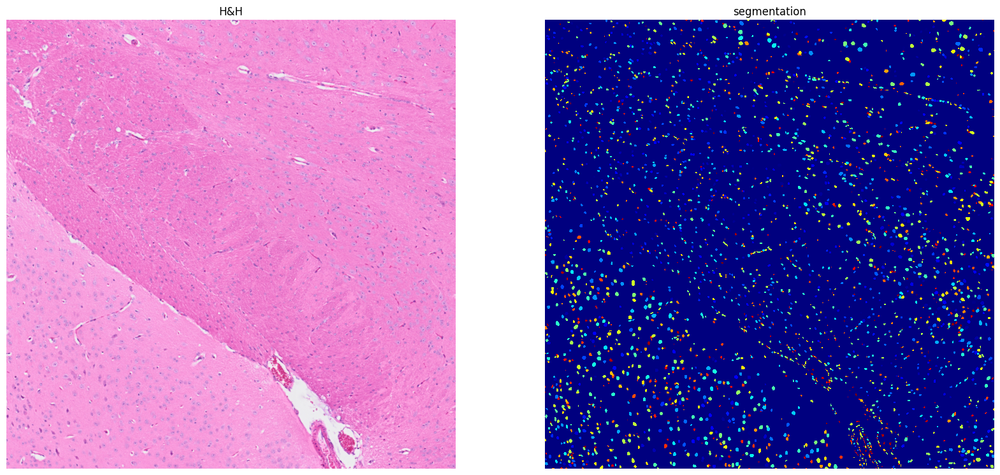

In [22]:
i= loop*3
j = loop*2
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


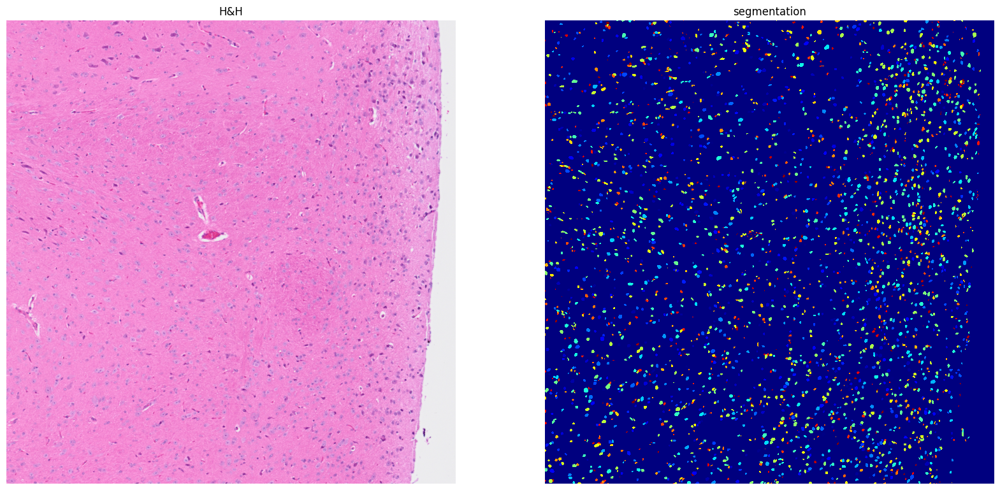

In [23]:
i= loop*3
j = loop*3
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


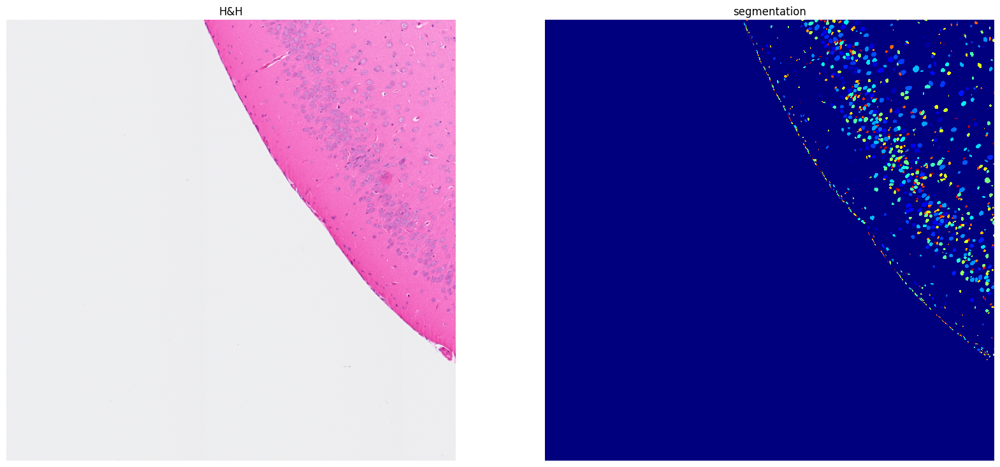

In [24]:
i= loop*4
j = loop*0
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


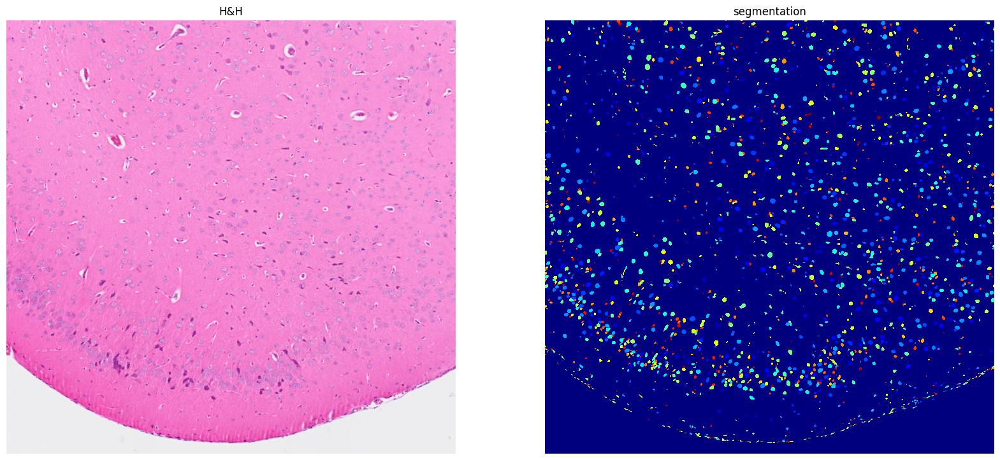

In [25]:
i= loop*4
j = loop*1
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


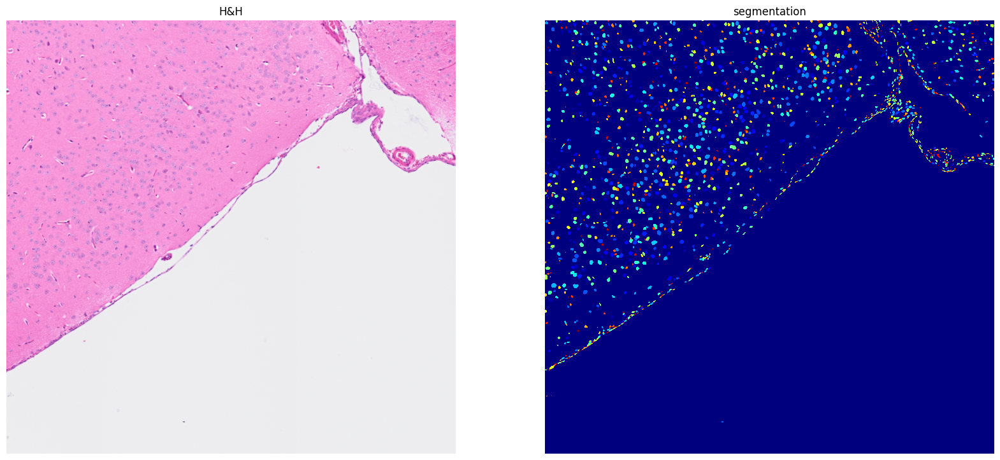

In [26]:
i= loop*4
j = loop*2
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.


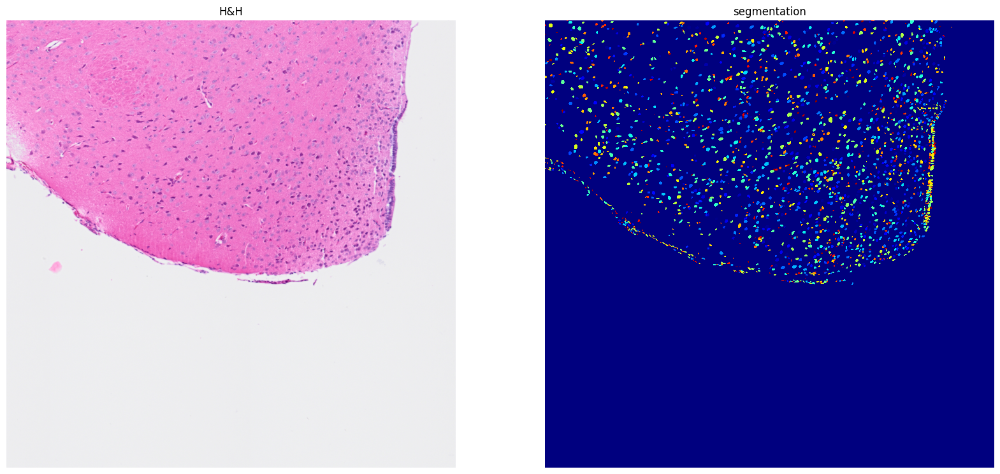

In [27]:
i= loop*4
j = loop*3
a_t = so.image_temp()[max(0,i-gap):min(i+loop,i_max),max(0,j-gap):min(j+loop,j_max)]

a = sq.im.ImageContainer(img=a_t, layer='image', lazy=True, scale=1.0, )
        
sq.im.segment(
    img=a,
    layer="image",
    channel=None,
    method=stardist_2D_versatile_he,
    layer_added="segmented_stardist",
    prob_thresh=0.01,
    nms_thresh=None,
)

fig, axes = plt.subplots(1, 2, figsize=(20, 10))
a.show("image", ax=axes[0])
_ = axes[0].set_title("H&H")
a.show("segmented_stardist", cmap="jet", interpolation="none", ax=axes[1])
_ = axes[1].set_title("segmentation")


segmentation_results[(i,j)] = np.array(a['segmented_stardist'][:,:,0,0])

If you have your own results, please do:

```python
# Assigning the final segmentation results
so.segmentation_final = results
```

Note that `so.segmentation_final` should be a numpy array with the same shape as `so.image_temp()`.


In [28]:
so.add_segmentation(segmentation_results , i_max, j_max, loop, gap)

We begin by generating relevant information for the analysis.

In [29]:
so.generate_cell_spots_information()

Generating cells information.


100%|██████████| 23340/23340 [01:05<00:00, 354.90it/s]


Generating spots information.


100%|██████████| 23340/23340 [02:58<00:00, 131.12it/s]


Filtering cells
We have 57300 nuclei in total.
Creating NN network


Visualize the nuclei segmentation results overlaid on the original HE or DAPI image.

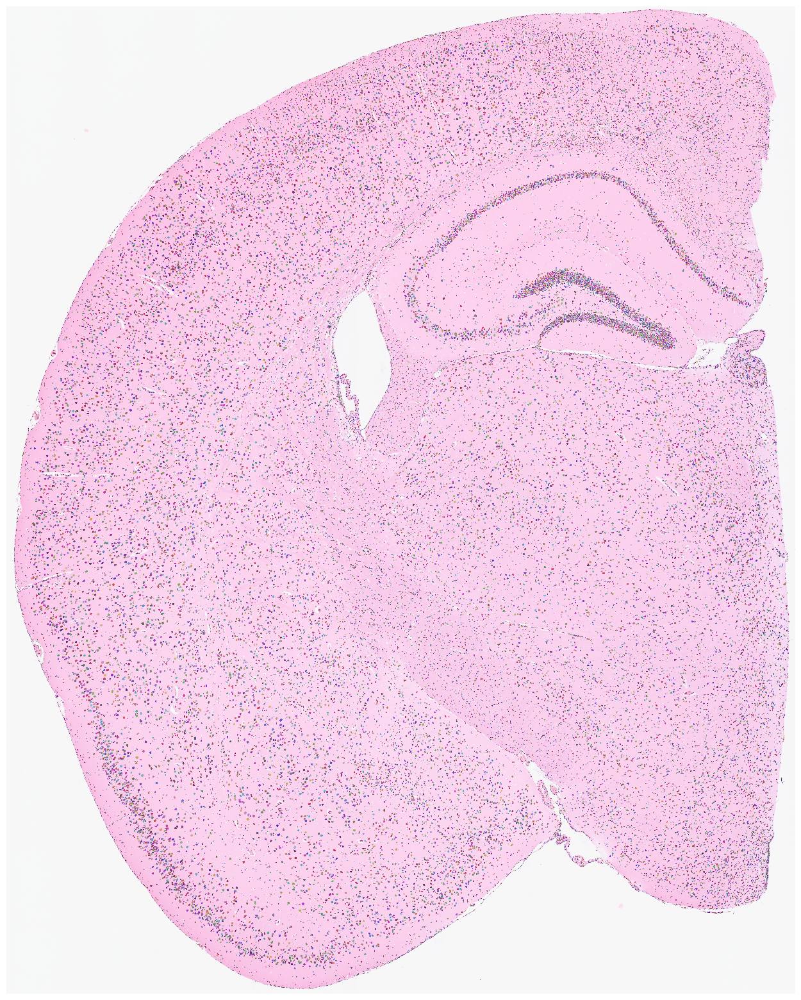

In [30]:
su.plot_results(so.image_temp(), so.segmentation_final, dpi = 2500 )

In [31]:
import pickle
with open(save_path + "so.pkl", 'wb') as f:
    pickle.dump(so, f)